In [1]:
# Methods that will be compared
# VIF:   Visual information fidelity using given data ________________ Done
# FSIM:  Feature similarity index using given data ________________ Done
# GMSD:  Gradient magnitude similarity deviation using given data
# SSIM:  Structural similarity - scikit-learn ________________ Done
# MSSIM: Mean SSIM - scikit-learn ________________ Done
# MSE:   Mean squared error ________________ Done 
# PNSR:  Peak signal-to-noise ratio - scikit-learn ________________ Done
# Edge-emphasis SSIM

In [2]:
import numpy as np
import cv2 as cv
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import spearmanr
from scipy.ndimage import convolve
from scipy.ndimage import correlate
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import mean_squared_error as mse
import torch
import os
from pyiqa.archs import gmsd_arch
import torch
from my_ssim import SSIM as ssim
from my_ssim import MSSIM as mssim
from helper import LogisticCurve, load_gray_img
import time

C:\Users\dummy\AppData\Roaming\Python\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


<h2>Preparing the data</h2>

In [3]:
noise_types = {
    1: "Additive Gaussian noise",
    2: "Additive noise in color components is more intensive than additive noise in the luminance component",
    3: "Spatially correlated noise",
    4: "Masked noise",
    5: "High frequency noise",
    6: "Impulse noise",
    7: "Quantization noise",
    8: "Gaussian blur",
    9: "Image denoising",
    10: "JPEG compression",
    11: "JPEG2000 compression",
    12: "JPEG transmission errors",
    13: "JPEG2000 transmission errors",
    14: "Non eccentricity pattern noise",
    15: "Local block-wise distortions of different intensity",
    16: "Mean shift (intensity shift)",
    17: "Contrast change"
}

ref_path = "mos/reference_images/"
dst_path = "mos/distorted_images/"

start_time = time.time()

In [4]:
# Load refernce image -> get name -> get type of distortion
import scipy.io

mos_name = pd.read_csv("mos/mos_with_names.txt", sep=" ")
mos_std = pd.read_csv("mos/mos_std.txt", sep=" ")
given_psnr = pd.read_csv("mos/metrics_values/psnr.txt", header=None, names=["given_psnr"])
given_ssim = pd.read_csv("mos/metrics_values/ssim.txt", header=None, names=["given_ssim"])
given_mse = pd.read_csv("mos/metrics_values/mse.txt", header=None, names=["given_mse"])
given_mssim = pd.read_csv("mos/metrics_values/MSSIM.TXT", header=None, names=["given_mssim"])
given_uqi = pd.read_csv("mos/metrics_values/uqi.txt", header=None, names=["given_uqi"])
given_uqi = pd.read_csv("mos/metrics_values/vif.txt", header=None, names=["given_vif"])
df = pd.concat([mos_name, mos_std], axis=1)

df['dst_type'] = df['name'].apply(lambda x: int(x.split('_')[1]))
df['dst_level'] = df['name'].apply(lambda x: x.split('_')[2].split('.')[0])
df['var'] = df['std'] ** 2
df['ref'] = df['name'].apply(lambda x: x.split('_')[0])
# 10      JPEG compression
# 11      JPEG2000 compression
# 12      JPEG transmission error
# 13      JPEG2000 transmission error
# Although the paper used cross validated JPEG 11 and 12 we also use transmission error jpeg
ref_path = "mos/reference_images/"
dst_path = "mos/distorted_images/"

df = pd.concat([df, given_psnr, given_ssim, given_mse, given_mssim, given_uqi], axis=1)

# SSIM results came with TID2008 is the same as paper's result
# mat_data = scipy.io.loadmat('TID2008_SSIM_results.mat')
# print(mat_data.keys())
# mat_df = pd.DataFrame(mat_data['mos'], columns=['mos'])
# np.sum(mat_df.mos - df.mos) 
ref_images = [load_gray_img(ref_path + path + ".bmp") for path in df['ref']]
dst_images = [load_gray_img(dst_path + path) for path in df['name']]

In [5]:
image_names = df['ref'].unique()
image_names

array(['I01', 'I02', 'I03', 'I04', 'I05', 'I06', 'I07', 'I08', 'I09',
       'I10', 'I11', 'I12', 'I13', 'I14', 'I15', 'I16', 'I17', 'I18',
       'I19', 'I20', 'I21', 'I22', 'I23', 'I24', 'I25'], dtype=object)

In [6]:
# FSIM results
import scipy.io

# Load the .mat file # https://www4.comp.polyu.edu.hk/~cslzhang/IQA/FSIM/FSIM.htm
mat_data = scipy.io.loadmat('FSIM.mat')
fsim = mat_data['FSIMOnTID2008'][:, 0]
fscimc = mat_data['FSIMOnTID2008'][:,1]
fsim_mos = mat_data['FSIMOnTID2008'][:,2]

# Checking if the MOS of FSIMOnTID2008 align with current dataset
np.unique(fsim_mos - df['mos'])

df['given_fsim'] = fsim
df['given_fsimc'] = fscimc

In [7]:
# GMSD results
# ict_keys(['__header__', '__version__', '__globals__', 'mos_tid', 'GMSD_tid'])
mat_data = scipy.io.loadmat('GMSD.mat')
gmsd_mos = mat_data['mos_tid'].flatten()
gmsd = mat_data['GMSD_tid'].flatten()

np.unique(gmsd_mos - df['mos'])

df['given_gmsd'] = gmsd

In [8]:
df.head(5)

,mos,name,std,dst_type,dst_level,var,ref,given_psnr,given_ssim,given_mse,given_mssim,given_vif,given_fsim,given_fsimc,given_gmsd
0,5.9706,I01_01_1.bmp,0.10593,1,1,0.011221,I01,30.0738,0.9890,-63.92936,0.9893,0.7398,0.989234,0.987828,0.019055
1,5.4167,I01_01_2.bmp,0.13249,1,2,0.017554,I01,26.9981,0.9786,-129.79871,0.9793,0.6297,0.979594,0.976797,0.034918
2,4.5556,I01_01_3.bmp,0.12073,1,3,0.014576,I01,24.0162,0.9598,-257.90536,0.9628,0.5221,0.962151,0.956590,0.060035
3,4.3143,I01_01_4.bmp,0.09707,1,4,0.009423,I01,21.0157,0.9254,-514.64808,0.9338,0.4151,0.936738,0.925871,0.094122
4,6.1429,I01_02_1.bmp,0.14080,2,1,0.019825,I01,30.2320,0.9966,-61.64252,0.9971,0.8981,0.997141,0.995630,0.005311


<h2>Computing the IQA results</h2>

In [9]:
df['ssim_edge'] = [mssim(src, dst, edge=True) for (src, dst) in zip(ref_images, dst_images)]

In [10]:
df['mssim_edge'] = [ssim(src, dst, edge=True) for (src, dst) in zip(ref_images, dst_images)]

In [11]:
df['mssim'] = [mssim(src, dst) for (src, dst) in zip(ref_images, dst_images)]

In [12]:
df['ssim'] = [ssim(src, dst) for (src, dst) in zip(ref_images, dst_images)]

In [13]:
df['mse'] = [-mse(src, dst) for (src, dst) in zip(ref_images, dst_images)] # Must convert to negative scale for representation

In [14]:
df['psnr'] = [psnr(src, dst) for (src, dst) in zip(ref_images, dst_images)]

<h2>Comparing results</h2>

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

def quality_assessment_generalized(df, metrics, compare_noises, noise_types, weights=None, graph=False):
    """
    Generalized function to calculate quality assessment for multiple metrics and n-types of noise.
    Optionally plots results using LogisticCurve.

    Parameters:
        df (DataFrame): The data containing the metrics and MOS scores.
        metrics (list of str): List of metric column names to evaluate.
        compare_noises (list of str): List of noise types to compare (e.g., [10, 11]).
        noise_types (dict): A dictionary mapping noise types to descriptive labels.
        weights (list or None): Weights for the logistic curve (optional).
        graph (bool): If True, generate plots; otherwise, only return performance metrics.

    Returns:
        tuple: If `graph=True`, returns (fig, axes, performance_df).
               If `graph=False`, returns only performance_df.
    """
    
    # Check if required columns exist in the DataFrame
    required_columns = ['mos'] + metrics
    for col in required_columns:
        if col not in df.columns:
            raise ValueError(f"Missing required column: {col}")
    
    performance_dict = {}  # Store performance metrics for each metric

    # Filter the dataframe to include only rows with selected noise types (10 and 11)
    df_filtered = df[df['dst_type'].isin(compare_noises)]
    
    # Only plot if `graph` is True
    if graph:
        num_metrics = len(metrics)
        num_cols = 2  # Number of plots per row
        num_rows = int(np.ceil(num_metrics / num_cols))  # Calculate the number of rows needed

        # Create a grid of subplots
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows))
        axes = np.array(axes).flatten()  # Flatten axes to simplify indexing
    
    for idx, metric in enumerate(metrics):
        # Fit a logistic curve using the LogisticCurve class, only on filtered data (noise 10 and 11)
        curve = LogisticCurve(df_filtered[metric], df_filtered['mos'], weights=weights)

        # Collect performance metrics
        performance_dict[metric] = curve.getPerformance(threshold=1, as_dataframe=False)

        if graph:
            ax = axes[idx]
            
            # Plot logistic fit curve
            ax.plot(curve.getX(), curve.getY(), color="red", label="Logistic Fit")
            
            # Scatter plot for each selected noise type (10 and 11)
            for noise in compare_noises:
                noise_data = df_filtered[df_filtered["dst_type"] == noise]
                ax.scatter(noise_data[metric], noise_data['mos'], 
                           label=f"{noise_types.get(noise, noise)} Images", s=10)
            
            # Title and labels
            weighted_label = "Weighted" if weights is not None else ""
            ax.set_title(f"{weighted_label} {metric.upper()} Image Quality Assessment")
            ax.set_xlabel(metric.upper())
            ax.set_ylabel('MOS')
            ax.legend(loc='best', prop={'size': 8})

    if graph:
        # Remove unused subplots
        for idx in range(len(metrics), len(axes)):
            fig.delaxes(axes[idx])
        
        # Adjust layout
        plt.tight_layout()
        performance_df = pd.DataFrame.from_dict(performance_dict, orient='index')
        performance_df.index.name = "Metric"
        performance_df.reset_index(inplace=True)
        return fig, axes[:len(metrics)], performance_df
    else:
        # Only return performance metrics
        performance_df = pd.DataFrame.from_dict(performance_dict, orient='index')
        performance_df.index.name = "Metric"
        performance_df.reset_index(inplace=True)
        return performance_df

C:\Python312\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


,Metric,CC,MAE,RMS,OR,SROCC
0,given_psnr,0.866644,0.701842,0.908137,0.035,0.877029
1,psnr,0.858267,0.757835,0.933103,0.035,0.866396
2,given_ssim,0.930727,0.367672,0.479832,0.005,0.963661
3,ssim,0.773469,0.762338,0.977348,0.070,0.854998
4,given_mse,0.792204,0.696719,0.904474,0.035,0.877029
5,mse,0.798328,0.755241,0.932126,0.040,0.866396
6,given_mssim,0.910158,0.385205,0.483125,0.000,0.957323
7,mssim,0.961232,0.367853,0.482791,0.000,0.962777
8,given_vif,0.924760,0.392794,0.541031,0.005,0.956287
9,given_gmsd,0.977568,0.295302,0.394274,0.000,0.976549


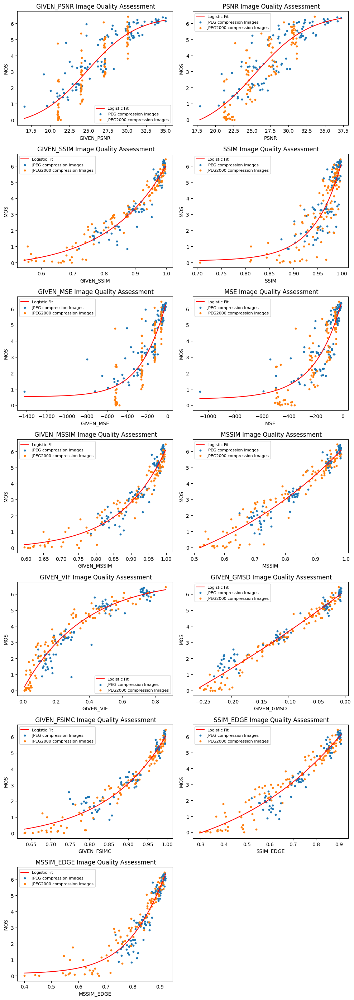

In [16]:
df['given_gmsd'] *= -1
noises_for_comparision = [10, 11]
# weight = df[df['dst_type'].isin(noises_for_comparision)]['var']
fig, axes, performance_dict = quality_assessment_generalized(df, 
                                                             ['given_psnr','psnr', 'given_ssim', 
                                                              'ssim', 'given_mse', 'mse', 'given_mssim', 'mssim',
                                                              'given_vif', 'given_gmsd', 'given_fsimc', 'ssim_edge', 
                                                              'mssim_edge'], 
                                                             noises_for_comparision, 
                                                             noise_types,
                                                             graph=True)
performance_dict

In [17]:
performance_dict.to_excel('tmp.xlsx')

<h2>Showing objective vs subjective results</h2>

In [18]:
def show_images(ref_imgs, dst_types, metrics=None):
    """
    Display reference images alongside their distorted versions, organized by distortion type.
    
    Parameters:
        ref_imgs (list): List of reference image identifiers.
        dst_types (list): List of distortion type identifiers.
        metrics (list): List of metric names to display below images.
    """
    rows = len(ref_imgs) * len(dst_types)  # Total rows = #ref_imgs * #dst_types
    fig, axes = plt.subplots(rows, 5, figsize=(25, 5 * rows))  # 5 images per row

    # Ensure axes is 2D, even if there's only one row
    if rows == 1:
        axes = axes.reshape(1, -1)

    row_idx = 0
    for ref_img in ref_imgs:
        for dst_type in dst_types:
            data = df[(df['ref'] == ref_img) & (df['dst_type'] == dst_type)]
            data_index = data.index

            # Plot the reference image in the first column
            axes[row_idx, 0].imshow(ref_images[data_index[0]], cmap="gray")
            axes[row_idx, 0].set_title(f"{ref_img} Reference", fontsize=12)
            axes[row_idx, 0].set_xticks([])
            axes[row_idx, 0].set_yticks([])
            axes[row_idx, 0].set_xlabel("Reference Image", fontsize=14)

            # Plot the distorted images in the remaining columns
            for i, idx in enumerate(data_index[:4]):  # Maximum 4 distortion levels
                axes[row_idx, i + 1].imshow(dst_images[idx], cmap="gray")
                axes[row_idx, i + 1].set_title(f"Dist. {dst_type} Level {i+1}", fontsize=12)
                axes[row_idx, i + 1].set_xticks([])
                axes[row_idx, i + 1].set_yticks([])

                # Collect metric values for this distortion level
                metric_text = ""
                for metric in metrics:
                    metric_value = data.at[idx, metric]
                    metric_text += f"{metric.upper()}: {metric_value:.4f}\n"

                # Display metrics below the image
                axes[row_idx, i + 1].set_xlabel(metric_text, fontsize=14)

            # Hide any unused axes for this row
            for i in range(len(data_index), 4):
                axes[row_idx, i + 1].axis('off')

            row_idx += 1

    # Adjust layout for better spacing
    fig.tight_layout()
    plt.show()


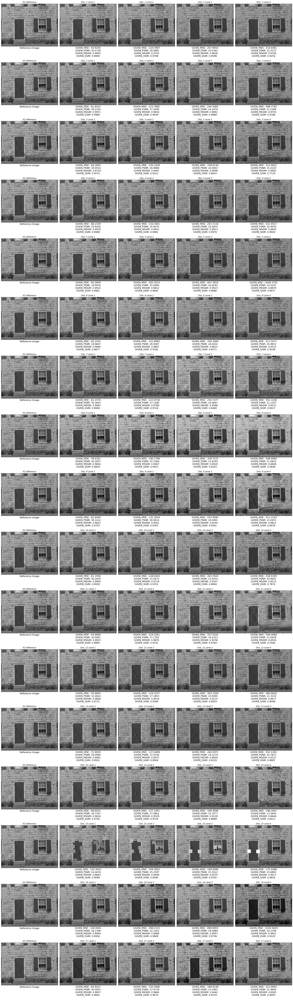

In [19]:
metric_list = ['given_psnr', 'given_ssim', 'given_mse', 'given_mssim', 'given_vif',
               'given_fsim', 'given_fsimc', 'given_gmsd', 'ssim_edge', 'mssim_edge',
               'mssim', 'ssim', 'mse', 'psnr']
show_images(["I01"], np.arange(1,18), ['given_mse', 'given_psnr', 'given_mssim', 'given_ssim'])

In [20]:
# metric_list = ['given_psnr', 'given_ssim', 'given_mse', 'given_mssim', 'given_vif',
#                'given_fsim', 'given_fsimc', 'given_gmsd', 'ssim_edge', 'mssim_edge',
#                'mssim', 'ssim', 'mse', 'psnr']
# # weight = df[df['dst_type'].isin(noises_for_comparision)]['var']
# for noise in range(1,18):
#     performance_dict = quality_assessment_generalized(df, metric_list, [noise], noise_types, graph=False)
#     performance_dict.to_csv(f"performance_csv/{noise_types[noise]}.csv", sep=',', index=False)
#     performance_dict.to_excel(f"performance_xlsx/{noise_types[noise]}.xlsx")

# end_time = time.time()

# print(f"Processed finished in: {end_time - start_time}")